# PROJET 4 : ANTICIPEZ LES BESOINS EN CONSOMMATION ÉLECTRIQUE DE BÂTIMENTS (MODÈLES)

## 0 - PRÉALABLES :

In [1]:
# Suppression des avertissements :
import warnings
warnings.filterwarnings('ignore')

### A - Importation des librairies :

In [2]:
# basics :
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from time import process_time

# preprocessing :
from sklearn.impute import KNNImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import RobustScaler

# model_selection & metrics :
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import learning_curve
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.feature_selection import RFECV
from time import process_time

# models :
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.svm import LinearSVR
from sklearn.ensemble import RandomForestRegressor
import xgboost as xgb
from xgboost import XGBRegressor

# XAI :
import lime
import lime.lime_tabular
import shap

# Export :
import joblib

### B - Importation du fichier :

In [3]:
# Importation du fichier :
data = pd.read_csv("df.csv")
data.drop(columns={"Unnamed: 0","ID"}, inplace=True)

## I - Preprocessing :

### A - imputation des valeurs manquantes des variables numériques :

In [4]:
# Imputations des variables numériques :
imputer = KNNImputer(n_neighbors=5)
numericals = data.select_dtypes(np.number)
numcol = data.select_dtypes(np.number).columns
numericals = pd.DataFrame(imputer.fit_transform(numericals), columns=numcol)

### B - Encodage des variables catégorielles : 

In [5]:
# Encodage des variables catégorielles :
transformer = OneHotEncoder(sparse=False)
categoricals = pd.DataFrame(transformer.fit_transform(data.select_dtypes("object")))
feature_names = transformer.get_feature_names_out(input_features=None)
categoricals = categoricals.astype("int")
categoricals.columns = feature_names

### C - Passage au logarithme :

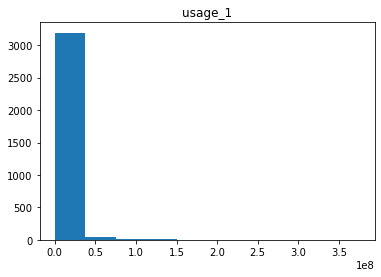

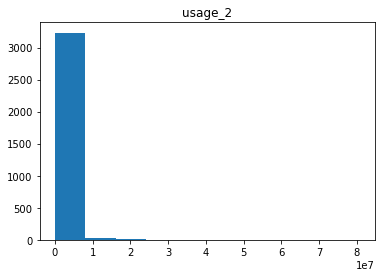

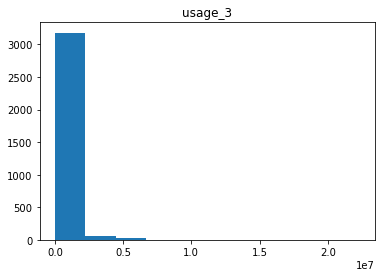

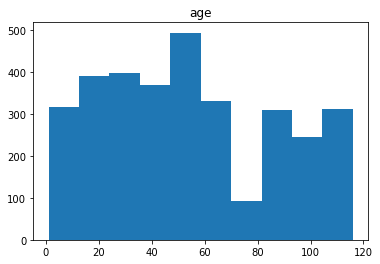

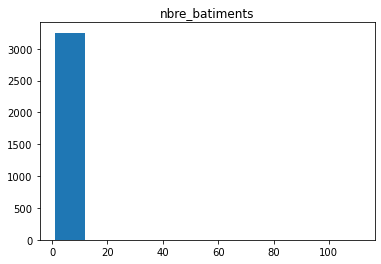

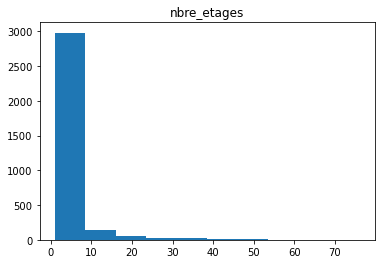

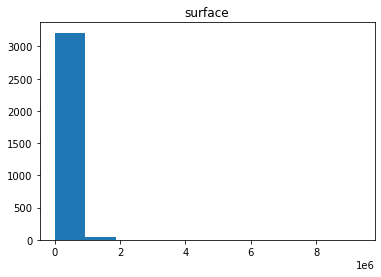

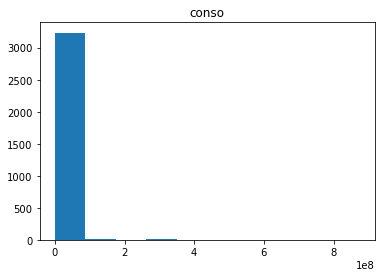

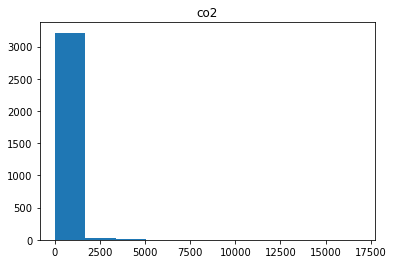

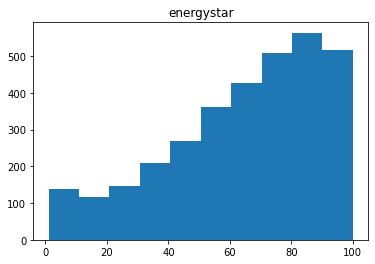

In [6]:
# Affichage des distributions des variables :
for c in numericals.columns :
    plt.figure()
    plt.hist(numericals[c])
    plt.title(f"{c}")

In [7]:
# Passage au logarithme :
numericals = np.log(numericals, where=numericals>0)

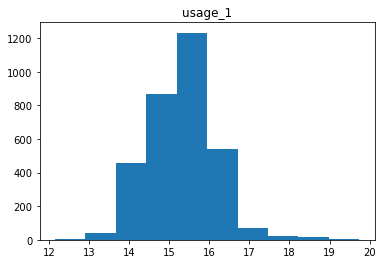

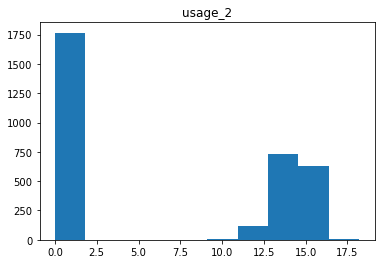

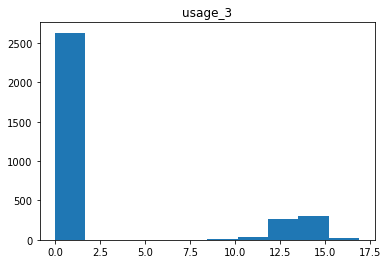

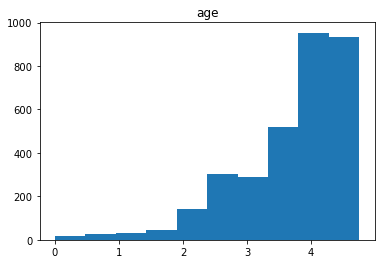

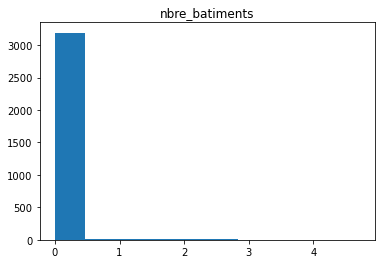

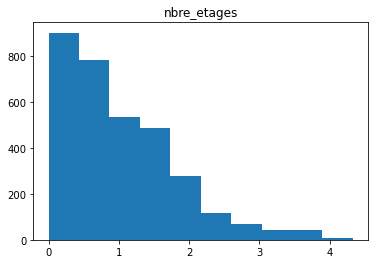

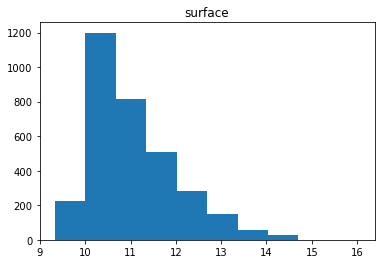

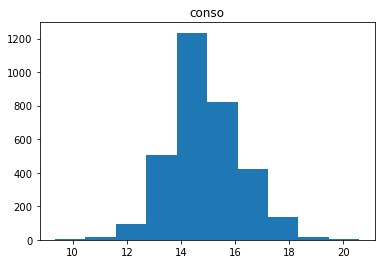

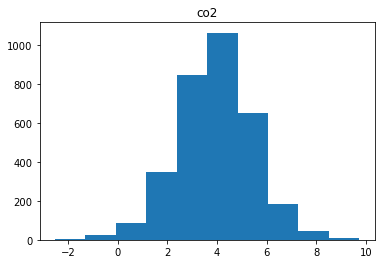

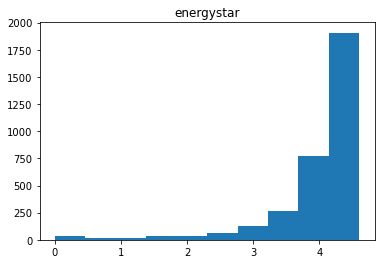

In [8]:
# Affichage des distributions après passage au logarithme :
for c in numericals.columns :
    plt.figure()
    plt.hist(numericals[c])
    plt.title(f"{c}")

### D - Standardisation :

In [9]:
# Standardisation des données :
scaler = RobustScaler()
numericals[["usage_1", "usage_2", "usage_3", "age","nbre_batiments","nbre_etages","surface","energystar"]] = scaler.fit_transform(numericals[["usage_1", "usage_2", "usage_3", "age","nbre_batiments","nbre_etages","surface","energystar"]])

### E - Jointure des deux types de variables :

In [10]:
# Jointure des deux types de variables :
df = numericals.join(categoricals)

In [11]:
data

,usage_1,usage_2,usage_3,age,quartier,nbre_batiments,nbre_etages,surface,conso,co2,energystar
0,1.213093e+07,0.000000e+00,0.000000,88,Downtown,1.0,12.0,88434,6.981428e+06,249.43,65.0
1,1.213093e+07,0.000000e+00,0.000000,89,Downtown,1.0,12.0,88434,7.226362e+06,249.98,60.0
2,9.825064e+06,2.240493e+06,676693.841531,19,Downtown,1.0,11.0,103566,8.354235e+06,263.51,51.0
3,9.825064e+06,2.240493e+06,676693.841531,20,Downtown,1.0,11.0,103566,8.387933e+06,295.86,61.0
4,9.549021e+06,1.601216e+06,0.000000,46,Downtown,1.0,41.0,961990,7.313066e+07,2061.48,18.0
...,...,...,...,...,...,...,...,...,...,...,...
3253,8.245046e+06,0.000000e+00,0.000000,26,Greater Duwamish,1.0,1.0,12294,8.497457e+05,20.94,46.0
3254,5.788456e+06,0.000000e+00,0.000000,12,Downtown,1.0,1.0,16000,9.502762e+05,32.17,NaN
3255,3.336161e+06,1.842166e+06,0.000000,42,Magnolia / Queen Anne,1.0,1.0,13157,5.765898e+06,223.54,NaN
3256,2.709709e+06,2.004698e+06,222306.098186,27,Greater Duwamish,1.0,1.0,14101,7.194712e+05,22.11,NaN


### E - Constitution des sets :

In [12]:
# Constitution des sets :
trainset, testset = train_test_split(df, test_size=0.33, random_state=3)
X_train, y_train, y_train2 = trainset.drop(columns = ["conso", "co2","energystar"]), trainset["conso"].values, trainset["co2"].values 
X_test, y_test, y_test2 = testset.drop(columns = ["conso", "co2","energystar"]), testset["conso"].values, testset["co2"].values

## II - Préparation à l'évaluation des modèles :

In [13]:
# Création d'un collecteur des erreurs
scores = pd.DataFrame(columns=["Label","MAE", "MAPE", "RMSE", "R²", "Time"])

In [14]:
# Fonction d'évaluation de modèles d'apprentissage qui collecte et donnent différents scores,
# et tracent une learning curve ainsi qu'un barplot des coefficients de variables.

def evaluation (model, collector=scores, X=X_train, y=y_train, Xt=X_test, yt=y_test, label="conso", cv=10, type_coef="A") :
    
    # Récupération des scores après cross validation :
    MAE = abs(cross_val_score(model, np.exp(Xt), np.exp(yt), cv=cv, scoring="neg_mean_absolute_error").mean())
    MAPE = abs(cross_val_score(model, np.exp(Xt), np.exp(yt), cv=cv, scoring="neg_mean_absolute_percentage_error").mean())
    RMSE = abs(cross_val_score(model, np.exp(Xt), np.exp(yt), cv=cv, scoring="neg_root_mean_squared_error").mean())
    r_squared = cross_val_score(model, Xt, yt, cv=cv, scoring="r2").mean()
    time = process_time()
    
    # Enregistrement et affichage des scores :
    collector=collector
    collector.loc[str(model) + str(" - ") + str(label)] = (label, MAE, MAPE, RMSE, r_squared, time)
    print(collector.loc[str(model) + str(" - ") + str(label)])
        
    # Learning curve :
    N, train_score, val_score = learning_curve(model, X, y, cv=cv, scoring="neg_mean_absolute_percentage_error", train_sizes=np.linspace(0.1,1,10))
    plt.figure()
    plt.plot(N, train_score.mean(axis=1), label="train score")
    plt.plot(N, val_score.mean(axis=1), label="val score")
    plt.legend()
    plt.ylabel("MAPE")
    plt.xlabel("Training Instance")
    plt.title("Learning Curve")
    plt.show()
    
    # Barplot des coefficients :
    if type_coef=="A" :
        model.fit(X, y)
        coefs = pd.DataFrame(model.coef_, columns=["Coefficients"], index=X.columns)
        coefs = coefs.sort_values(by="Coefficients")
        coefs.plot(kind='barh', figsize=(8, 6))
        plt.title(model)
        plt.axvline(x=0, color=".5")
        plt.subplots_adjust(left=.3)
        
    elif type_coef=="B" :
        model.fit(X, y)
        coefs = pd.DataFrame(model.feature_importances_, columns=["Coefficients"], index=X.columns)
        coefs = coefs.sort_values(by="Coefficients")
        coefs.plot(kind='barh', figsize=(8, 6))
        plt.title(model)
        plt.axvline(x=0, color=".5")
        plt.subplots_adjust(left=.3)

### B - Baseline (Linear Regression) :

Label              conso
MAE       5662447.596613
MAPE            3.485242
RMSE     11546410.473728
R²              0.688554
Time            6.171875
Name: LinearRegression() - conso, dtype: object


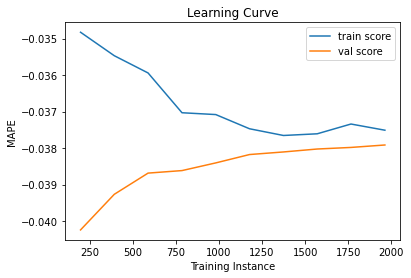

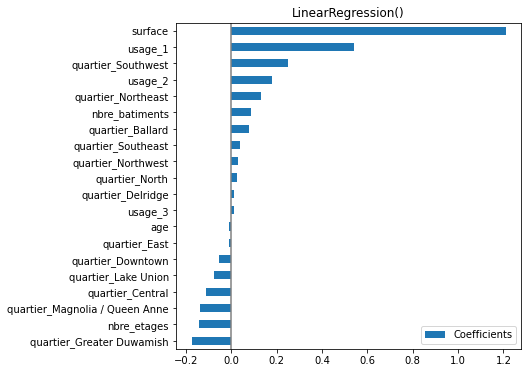

In [15]:
# Évaluation de la baseline :
linear_reg = LinearRegression()
evaluation(LinearRegression())

Label           co2
MAE      210.426556
MAPE      11.301579
RMSE     446.511504
R²         0.443752
Time       9.734375
Name: LinearRegression() - co2, dtype: object


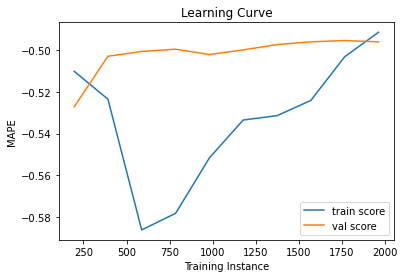

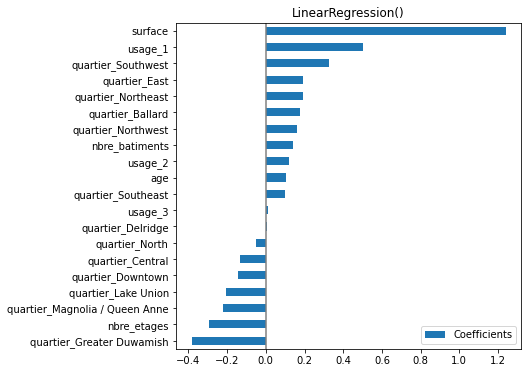

In [16]:
# Évaluation de la baseline co2 :
evaluation(linear_reg, y=y_train2, yt=y_test2, label="co2")

## III - Évaluation des modèles :

### A - Ridge Regression :

#### 1) Sur la consommation d'énergie :

In [17]:
# Récupération des meilleurs hyperparamètres (consommation d'énergie):
parameters = {"alpha" : np.arange(0,5,step=0.1)}
grid_model = GridSearchCV(Ridge(), parameters, cv=5)
grid_model.fit(X_train, y_train)
grid_model.best_params_

{'alpha': 4.9}

Label              conso
MAE       5648601.636109
MAPE            3.470411
RMSE     11536048.023713
R²              0.689335
Time            16.34375
Name: Ridge(alpha=4.9) - conso, dtype: object


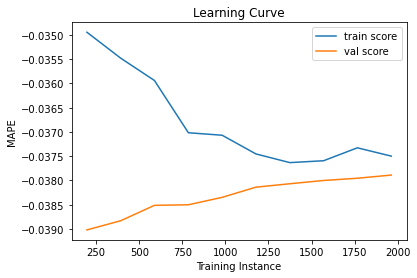

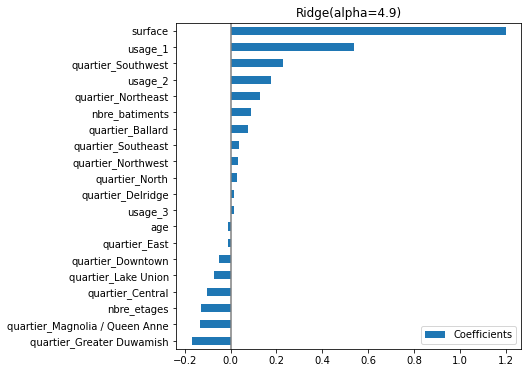

In [18]:
# Évaluation sur la consommation d'énergie :
ridge_reg = Ridge(**grid_model.best_params_)
evaluation(ridge_reg)

#### 2) Sur l'émission de CO2 :

In [19]:
# Récupération des meilleurs hyperparamètres (émission de CO2):
grid_model = GridSearchCV(Ridge(), parameters, cv=4)
grid_model.fit(X_train, y_train2)
grid_model.best_params_

{'alpha': 4.9}

Label           co2
MAE      209.660579
MAPE      11.253705
RMSE     446.004912
R²         0.445155
Time        22.3125
Name: Ridge(alpha=4.9) - co2, dtype: object


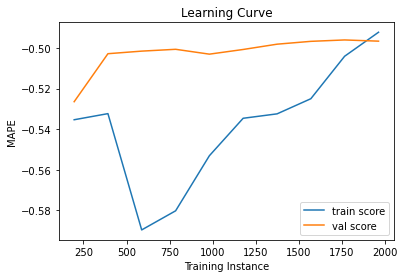

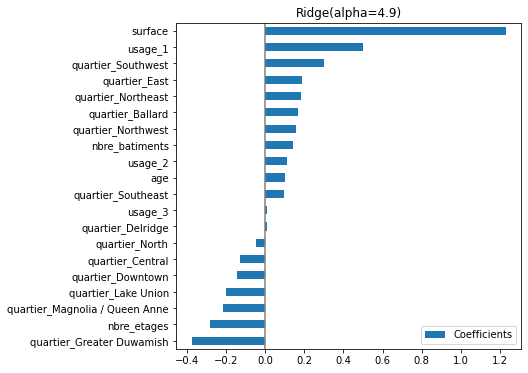

In [20]:
# Évaluation sur l'émission de CO2 :
ridge_reg = Ridge(**grid_model.best_params_)
evaluation(ridge_reg, y=y_train2, yt=y_test2, label="co2")

### B - Support Vector Regression :

#### 1) Sur la consommation d'énergie :

In [21]:
# Définition de la recherche aléatoire :
random_grid = {"C" : [0.01, 0.1, 1, 10, 100],
               "epsilon" : [0.001, 0.01, 0.1, 1, 10],
               "loss" : ["epsilon_insensitive", "squared_epsilon_insensitive"],
               "tol" : [0.0001, 0.001, 0.01, 0.1]}

In [22]:
# Random grid :
random_search = RandomizedSearchCV(estimator=LinearSVR(), param_distributions=random_grid, n_iter=30, cv=5)
random_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=LinearSVR(), n_iter=30,
                   param_distributions={'C': [0.01, 0.1, 1, 10, 100],
                                        'epsilon': [0.001, 0.01, 0.1, 1, 10],
                                        'loss': ['epsilon_insensitive',
                                                 'squared_epsilon_insensitive'],
                                        'tol': [0.0001, 0.001, 0.01, 0.1]})

In [23]:
# Hyperparamètres sélectionnés par random grid :
random_search.best_params_

{'tol': 0.001, 'loss': 'squared_epsilon_insensitive', 'epsilon': 0.001, 'C': 1}

Label                conso
MAE      1316026654.895246
MAPE            531.751255
RMSE     4779136521.550138
R²                0.688649
Time               31.0625
Name: LinearSVR(C=1, epsilon=0.001, loss='squared_epsilon_insensitive', tol=0.001) - conso, dtype: object


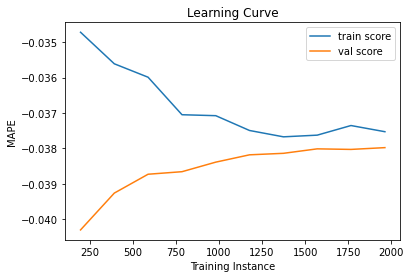

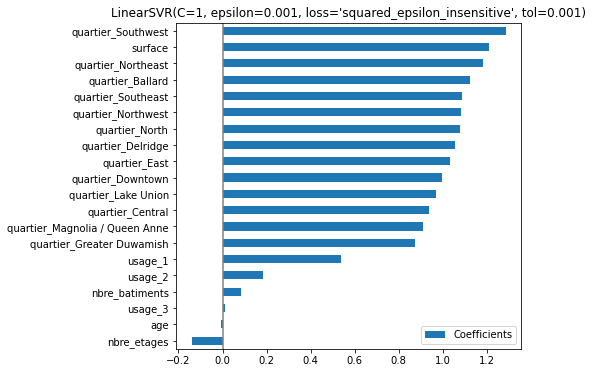

In [24]:
# Évaluation sur la consommation d'énergie :
SVReg = LinearSVR(**random_search.best_params_)
evaluation(SVReg)

#### 2) Sur l'émission de CO2 :

In [25]:
# Random grid :
random_search = RandomizedSearchCV(estimator=LinearSVR(), param_distributions=random_grid, n_iter=30, cv=5)
random_search.fit(X_train, y_train2)

RandomizedSearchCV(cv=5, estimator=LinearSVR(), n_iter=30,
                   param_distributions={'C': [0.01, 0.1, 1, 10, 100],
                                        'epsilon': [0.001, 0.01, 0.1, 1, 10],
                                        'loss': ['epsilon_insensitive',
                                                 'squared_epsilon_insensitive'],
                                        'tol': [0.0001, 0.001, 0.01, 0.1]})

In [26]:
# Hyperparamètres sélectionnés par random grid :
random_search.best_params_

{'tol': 0.01, 'loss': 'epsilon_insensitive', 'epsilon': 1, 'C': 1}

Label            co2
MAE      5214.187604
MAPE       40.676549
RMSE      505.558339
R²          0.439075
Time        52.28125
Name: LinearSVR(C=1, epsilon=1, tol=0.01) - co2, dtype: object


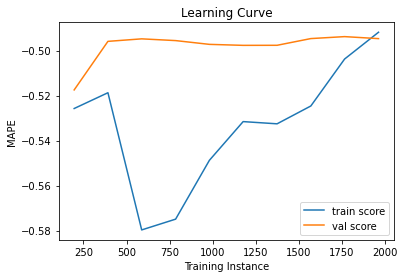

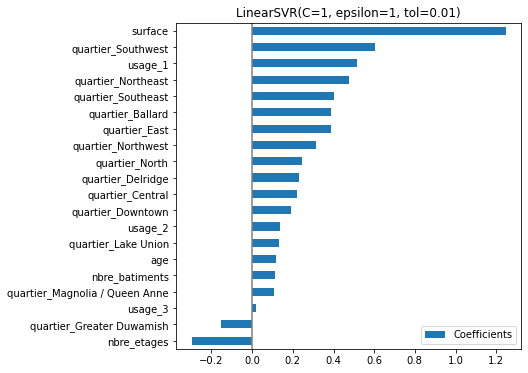

In [27]:
# Évaluation sur l'émission de co2 :
SVReg = LinearSVR(**random_search.best_params_)
evaluation(SVReg, y=y_train2, yt=y_test2, label="co2")

### C - Random Forest :

#### 1) Sur la consommation d'énergie :

In [28]:
# Définition de la recherche aléatoire :
random_grid = {"n_estimators" : [200],
               "max_features" : ["auto","sqrt"],
               "max_depth" : [None, 10, 40, 80, 100, 200],
               "min_samples_split" : [1,2,3],
               "min_samples_leaf" : [1,2,3],
               "bootstrap" : [True, False]}

In [29]:
# Random grid :
random_search = RandomizedSearchCV(estimator=RandomForestRegressor(), param_distributions=random_grid, n_iter=20, cv=5)
random_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=20,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [None, 10, 40, 80, 100,
                                                      200],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 3],
                                        'min_samples_split': [1, 2, 3],
                                        'n_estimators': [200]})

In [30]:
# Hyperparamètres sélectionnés par random grid :
random_search.best_params_

{'n_estimators': 200,
 'min_samples_split': 3,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 40,
 'bootstrap': False}

Label              conso
MAE       3403273.260436
MAPE            1.097336
RMSE     11078298.489771
R²              0.746185
Time            123.5625
Name: RandomForestRegressor(bootstrap=False, max_depth=40, max_features='sqrt',\n                      min_samples_split=3, n_estimators=200) - conso, dtype: object


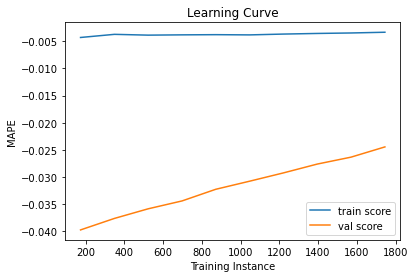

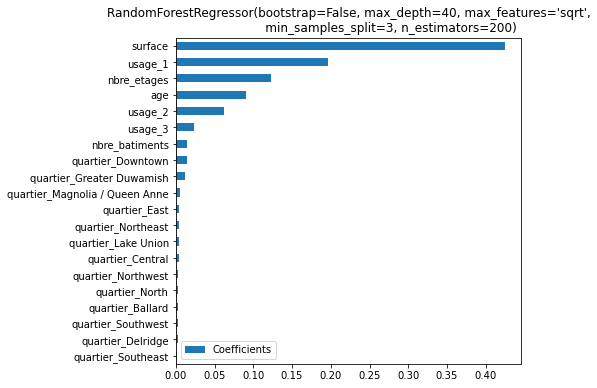

In [31]:
# Évaluation sur la consommation d'énergie :
RFR = RandomForestRegressor(**random_search.best_params_)
evaluation(RFR, type_coef="B", cv=5)

#### 2) Sur l'émission de CO2 :

In [32]:
# Random grid :
random_search = RandomizedSearchCV(estimator=RandomForestRegressor(), param_distributions=random_grid, n_iter=20, cv=5)
random_search.fit(X_train, y_train2)

RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=20,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [None, 10, 40, 80, 100,
                                                      200],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 3],
                                        'min_samples_split': [1, 2, 3],
                                        'n_estimators': [200]})

In [33]:
# hyperparamètres sélectionnés par random grid :
random_search.best_params_

{'n_estimators': 200,
 'min_samples_split': 2,
 'min_samples_leaf': 1,
 'max_features': 'sqrt',
 'max_depth': 80,
 'bootstrap': False}

Label           co2
MAE       103.43352
MAPE       3.034962
RMSE     309.702367
R²         0.552997
Time     201.703125
Name: RandomForestRegressor(bootstrap=False, max_depth=80, max_features='sqrt',\n                      n_estimators=200) - co2, dtype: object


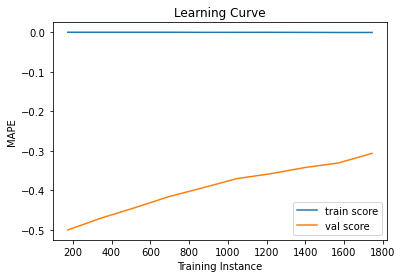

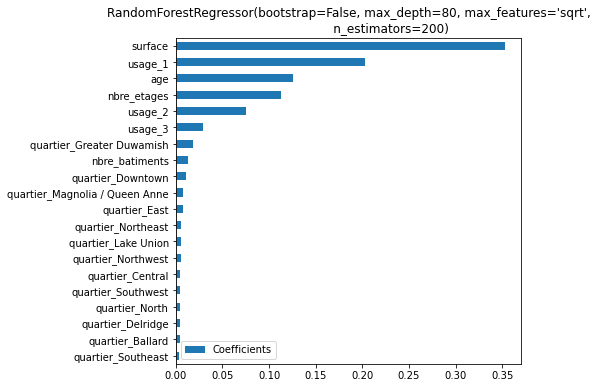

In [34]:
# Évaluation sur l'émission de co2 :
RFR = RandomForestRegressor(**random_search.best_params_)
evaluation(RFR, y=y_train2, yt=y_test2, type_coef="B", label="co2", cv=5)

### D - XGBoost :

#### 1) Sur la consommation d'énergie :

In [35]:
# Définition de la recherche aléatoire :
random_grid = {"learning_rate" : [0.01, 0.05, 0.1, 0.2, 0.4, 0.6, 0.8],
               "eval_metric" : ["mape"],
               "seed" : [42],
               "max_depth" : [None, 2, 10, 50],
               "subsample" : [0.8, 1, 1.2],
               "n_estimators" : [200]}

In [36]:
# Random grid :
random_search = RandomizedSearchCV(estimator=XGBRegressor(), param_distributions=random_grid, n_iter=20, cv=5)
random_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None,
                                          enable_categorical=False, gamma=None,
                                          gpu_id=None, importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=...
                                          num_parallel_tree=None,
                                          predictor=None, random_state=None,
                                          reg_al

In [37]:
# Hyperparamètres sélectionnés par random grid :
random_search.best_params_

{'subsample': 0.8,
 'seed': 42,
 'n_estimators': 200,
 'max_depth': 50,
 'learning_rate': 0.05,
 'eval_metric': 'mape'}

Label             conso
MAE      3022187.219401
MAPE            0.85076
RMSE     9120816.620743
R²             0.752908
Time         637.046875
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.05, max_delta_step=None, max_depth=50,\n             min_child_weight=None, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, verbosity=None) - conso, dtype: object


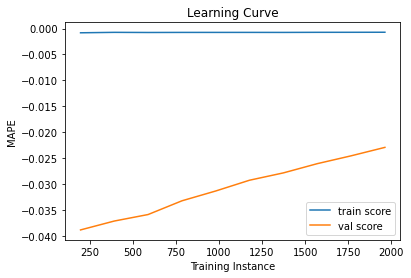

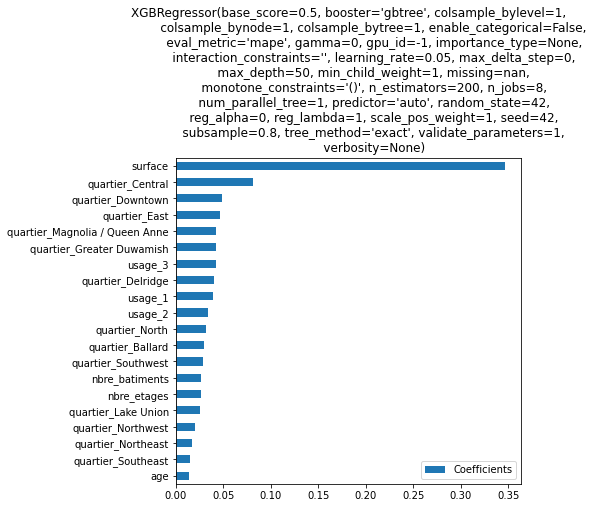

In [38]:
# XGBoost :
XGB = XGBRegressor(**random_search.best_params_)
evaluation(XGB, type_coef="B")

#### 2) Sur l'émission de CO2 :

In [39]:
# Random grid :
random_search = RandomizedSearchCV(estimator=XGBRegressor(), param_distributions=random_grid, n_iter=30, cv=5)
random_search.fit(X_train, y_train2)

RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None,
                                          enable_categorical=False, gamma=None,
                                          gpu_id=None, importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=None,
                                          max_delta_step=None, max_depth=None,
                                          min_child_weight=None, missing=nan,
                                          monotone_constraints=...
                                          num_parallel_tree=None,
                                          predictor=None, random_state=None,
                                          reg_al

In [40]:
# Hyperparamètres sélectionnés par random grid :
random_search.best_params_

{'subsample': 0.8,
 'seed': 42,
 'n_estimators': 200,
 'max_depth': 50,
 'learning_rate': 0.05,
 'eval_metric': 'mape'}

Label            co2
MAE        96.029022
MAPE         2.52281
RMSE      304.844147
R²           0.53834
Time     1724.734375
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.05, max_delta_step=None, max_depth=50,\n             min_child_weight=None, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, verbosity=None) - co2, dtype: object


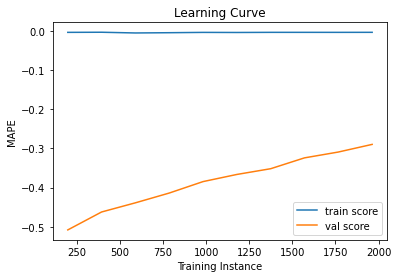

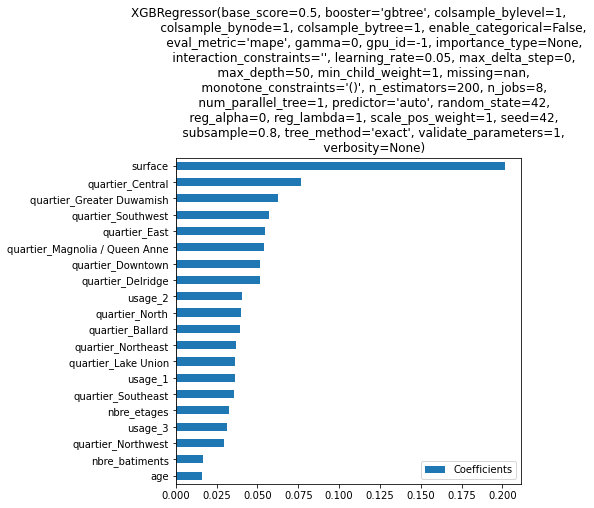

In [41]:
# XGBoost :
XGB = XGBRegressor(**random_search.best_params_)
evaluation(XGB, y=y_train2, yt=y_test2, type_coef="B", label="co2")

## IV - Choix (XGBoost) et optimisation des modèles :

### A - Choix des modèles :

#### 1) Tableau récapitulatif des scores :

In [42]:
# Tableau récapitulatif consommation d'énergie :
scores[scores["Label"]=="conso"]

,Label,MAE,MAPE,RMSE,R²,Time
LinearRegression() - conso,conso,5.662448e+06,3.485242,1.154641e+07,0.688554,6.171875
Ridge(alpha=4.9) - conso,conso,5.648602e+06,3.470411,1.153605e+07,0.689335,16.343750
"LinearSVR(C=1, epsilon=0.001, loss='squared_epsilon_insensitive', tol=0.001) - conso",conso,1.316027e+09,531.751255,4.779137e+09,0.688649,31.062500
"RandomForestRegressor(bootstrap=False, max_depth=40, max_features='sqrt',\n min_samples_split=3, n_estimators=200) - conso",conso,3.403273e+06,1.097336,1.107830e+07,0.746185,123.562500
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.05, max_delta_step=None, max_depth=50,\n min_child_weight=None, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, verbosity=None) - conso",conso,3.022187e+06,0.850760,9.120817e+06,0.752908,637.046875


In [43]:
# Tableau récapitulatif émission de CO2 :
scores[scores["Label"]=="co2"]

,Label,MAE,MAPE,RMSE,R²,Time
LinearRegression() - co2,co2,210.426556,11.301579,446.511504,0.443752,9.734375
Ridge(alpha=4.9) - co2,co2,209.660579,11.253705,446.004912,0.445155,22.312500
"LinearSVR(C=1, epsilon=1, tol=0.01) - co2",co2,5214.187604,40.676549,505.558339,0.439075,52.281250
"RandomForestRegressor(bootstrap=False, max_depth=80, max_features='sqrt',\n n_estimators=200) - co2",co2,103.433520,3.034962,309.702367,0.552997,201.703125
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.05, max_delta_step=None, max_depth=50,\n min_child_weight=None, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, verbosity=None) - co2",co2,96.029022,2.522810,304.844147,0.538340,1724.734375


#### 2) Choix des modèles :

### B - Optimisation des variables :

#### 1) pour la consommation d'énergie :

In [44]:
# RFECV :
rfecv = RFECV(estimator=XGBRegressor(**random_search.best_params_), 
              step=1, 
              cv=5,
              scoring='neg_mean_absolute_percentage_error')
rfecv.fit(X_train, y_train)

RFECV(cv=5,
      estimator=XGBRegressor(base_score=None, booster=None,
                             colsample_bylevel=None, colsample_bynode=None,
                             colsample_bytree=None, enable_categorical=False,
                             eval_metric='mape', gamma=None, gpu_id=None,
                             importance_type=None, interaction_constraints=None,
                             learning_rate=0.05, max_delta_step=None,
                             max_depth=50, min_child_weight=None, missing=nan,
                             monotone_constraints=None, n_estimators=200,
                             n_jobs=None, num_parallel_tree=None,
                             predictor=None, random_state=None, reg_alpha=None,
                             reg_lambda=None, scale_pos_weight=None, seed=42,
                             subsample=0.8, tree_method=None,
                             validate_parameters=None, verbosity=None),
      scoring='neg_mean_absolute_perce

In [45]:
# Nombre de variables optimales :
print("Optimum number of features: %d" % rfecv.n_features_)

Optimum number of features: 16


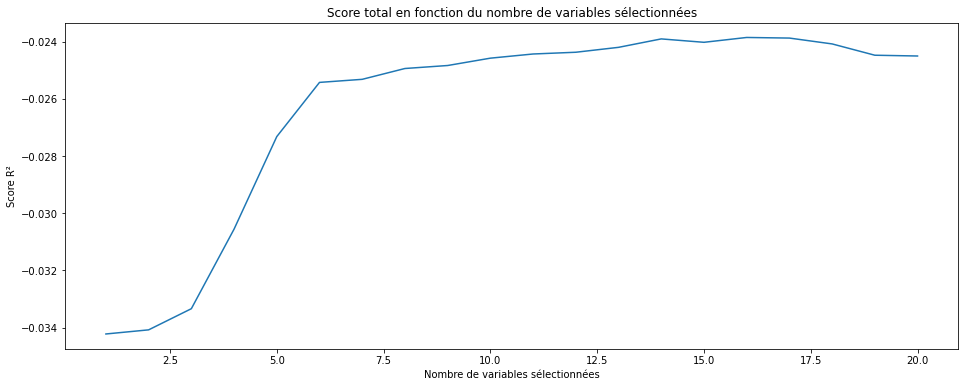

In [46]:
# Visualisation
plt.figure( figsize=(16, 6))
plt.title("Score total en fonction du nombre de variables sélectionnées")
plt.xlabel("Nombre de variables sélectionnées")
plt.ylabel("Score R²")
plt.plot(range(1, len(rfecv.cv_results_["mean_test_score"]) + 1), rfecv.cv_results_["mean_test_score"])
plt.show()

In [47]:
# Affichage des variables retirées par l'algorithme :
set(X_train.columns) - set(X_train[X_train.columns[rfecv.get_support(1)]])

{'age', 'quartier_Northeast', 'quartier_Northwest', 'quartier_Southeast'}

In [48]:
# Suppression des variables éliminées par RFECV :
X_train_RFECV_conso = X_train[X_train.columns[rfecv.get_support(1)]]
X_test_RFECV_conso = X_test[X_test.columns[rfecv.get_support(1)]]

Label             conso
MAE      3019413.713776
MAPE           0.882556
RMSE     8936525.298904
R²             0.740335
Time        3265.359375
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.05, max_delta_step=None, max_depth=50,\n             min_child_weight=None, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, verbosity=None) - conso, dtype: object


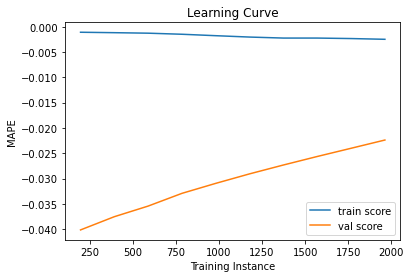

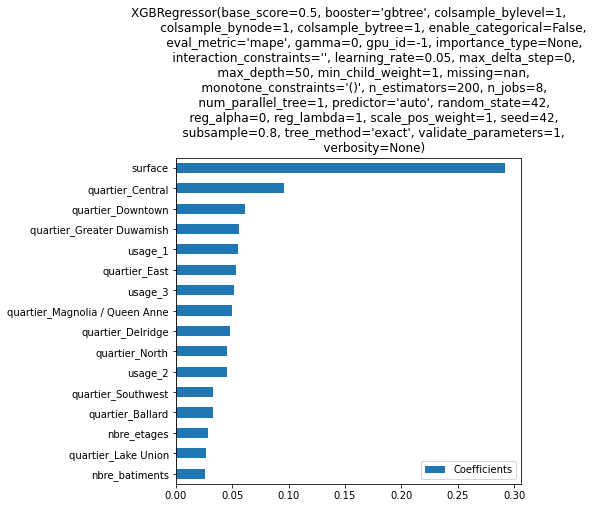

In [49]:
# Test après la suppression de la variable :
XGB = XGBRegressor(**random_search.best_params_)
evaluation(XGB, X=X_train_RFECV_conso, Xt=X_test_RFECV_conso, type_coef="B")

#### 2) Pour l'émission de CO2 :

In [50]:
# RFECV :
rfecv.fit(X_train, y_train2)

RFECV(cv=5,
      estimator=XGBRegressor(base_score=None, booster=None,
                             colsample_bylevel=None, colsample_bynode=None,
                             colsample_bytree=None, enable_categorical=False,
                             eval_metric='mape', gamma=None, gpu_id=None,
                             importance_type=None, interaction_constraints=None,
                             learning_rate=0.05, max_delta_step=None,
                             max_depth=50, min_child_weight=None, missing=nan,
                             monotone_constraints=None, n_estimators=200,
                             n_jobs=None, num_parallel_tree=None,
                             predictor=None, random_state=None, reg_alpha=None,
                             reg_lambda=None, scale_pos_weight=None, seed=42,
                             subsample=0.8, tree_method=None,
                             validate_parameters=None, verbosity=None),
      scoring='neg_mean_absolute_perce

In [51]:
# Nombre de variables optimales :
print("Optimum number of features: %d" % rfecv.n_features_)

Optimum number of features: 18


In [52]:
# Affichage des variables retirées par l'algorithme :
set(X_train.columns) - set(X_train[X_train.columns[rfecv.get_support(1)]])

{'age', 'nbre_batiments'}

In [53]:
# Suppression des variables éliminées par RFECV :
X_train_RFECV_co2 = X_train[X_train.columns[rfecv.get_support(1)]]
X_test_RFECV_co2 = X_test[X_test.columns[rfecv.get_support(1)]]

Label           co2
MAE       96.308932
MAPE       2.388745
RMSE     298.652395
R²         0.525554
Time        4798.25
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.05, max_delta_step=None, max_depth=50,\n             min_child_weight=None, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, verbosity=None) - co2, dtype: object


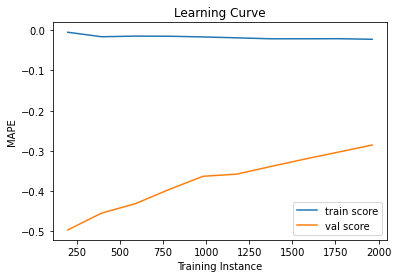

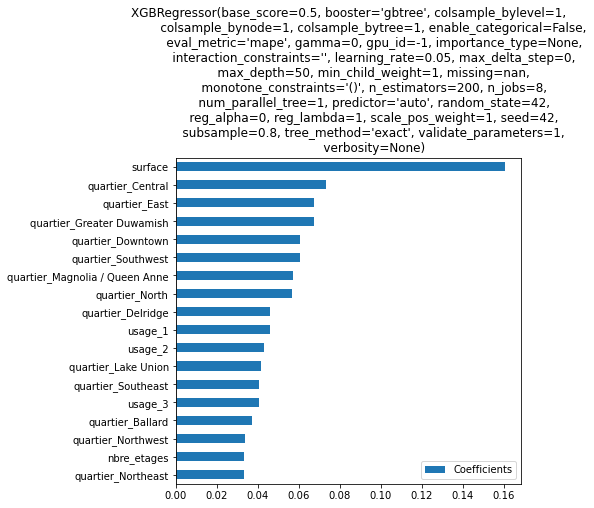

In [54]:
# Test après la suppression de la variable :
XGB = XGBRegressor(**random_search.best_params_)
evaluation(XGB, X=X_train_RFECV_co2, Xt=X_test_RFECV_co2, y=y_train2, yt=y_test2, type_coef="B", label="co2")

### C - Optimisation des hyperparamètres et résultats finaux :

Les réglages des hyperparamètres ont été précédemment effectués par une Random Grid Search, ce qui nous a permis à la fois de les optimiser tout en gagnant du temps. Cependant, cette méthode ne donne pas des hyperparamètres optimaux. Aussi, allons-nous essayer d'améliorer encore nos scores en nous appuyant sur nos premières estimations et en tentant de les optimiser.

#### 1) Pour la consommation d'énergie (optimisation des hyperparamètres) :¶

In [55]:
# Définitions des paramètres :
parameters = {"n_estimators" : [200],
              "max_depth" : [None, 50, 100],
              "learning_rate" : [0.1, 0.2],
              "min_child_weight" : [1, 2],
              "eta" : [1, 2],
              "subsample" : [0.8, 1],
              "eval_metric" : ["mape"],
              "seed" : [42]}

In [56]:
# Récupération des meilleurs hyperparamètres (consommation d'énergie toutes variables):
grid_model = GridSearchCV(XGBRegressor(), parameters, cv=5)
grid_model.fit(X_train, y_train)
grid_model.best_params_

{'eta': 1,
 'eval_metric': 'mape',
 'learning_rate': 0.1,
 'max_depth': 50,
 'min_child_weight': 2,
 'n_estimators': 200,
 'seed': 42,
 'subsample': 0.8}

Label             conso
MAE      3081540.598898
MAPE           0.818667
RMSE      9130347.67378
R²             0.755012
Time           6799.625
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.1, max_delta_step=None, max_depth=50,\n             min_child_weight=2, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, ...) - conso, dtype: object


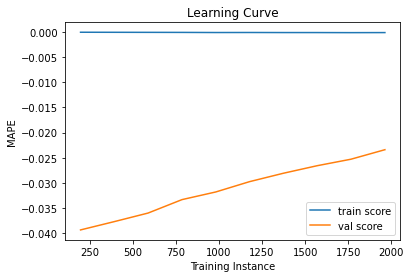

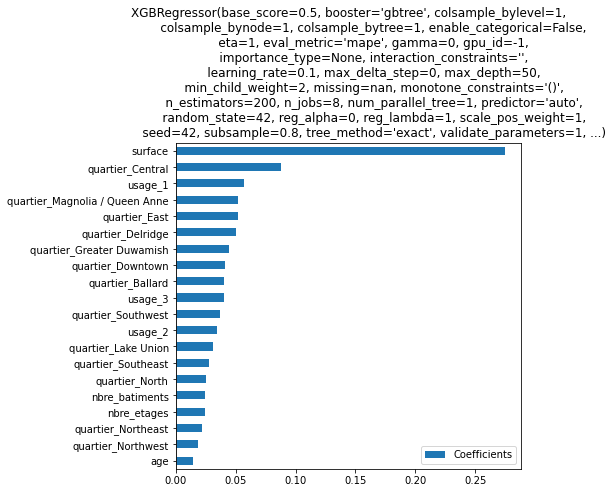

In [57]:
# XGBoost :
XGB = XGBRegressor(**grid_model.best_params_)
evaluation(XGB, type_coef="B")

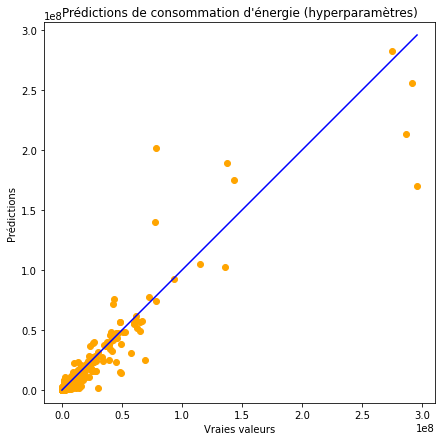

In [58]:
# Visualisation des prédictions :
XGB.fit(X_train, y_train)
predicted = XGB.predict(X_test)

plt.figure(figsize=(7,7))
plt.title("Prédictions de consommation d'énergie (hyperparamètres)")
plt.scatter(np.exp(y_test), np.exp(predicted), c="orange")
p1 = max(max(np.exp(predicted)), max(np.exp(y_test)))
p2 = min(min(np.exp(predicted)), min(np.exp(y_test)))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel("Vraies valeurs")
plt.ylabel("Prédictions")
plt.axis('equal')
plt.show()

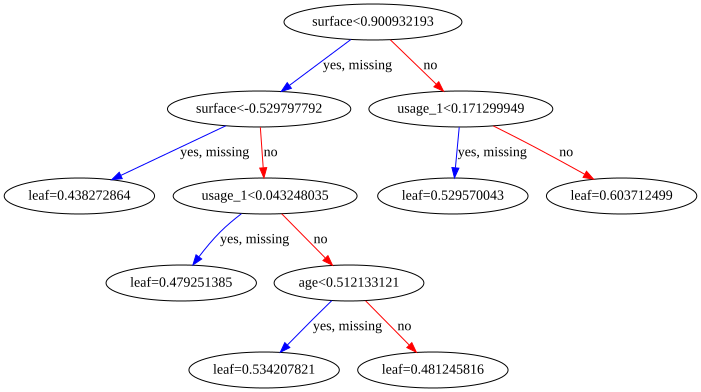

In [59]:
# Visualisation d'un arbre :
xgb.to_graphviz(XGB, num_trees=10)

In [60]:
# XAI (SHAP) :
shap.initjs()
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_train)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

In [61]:
# XAI (SHAP) :
shap.force_plot(explainer.expected_value, shap_values, X_train)

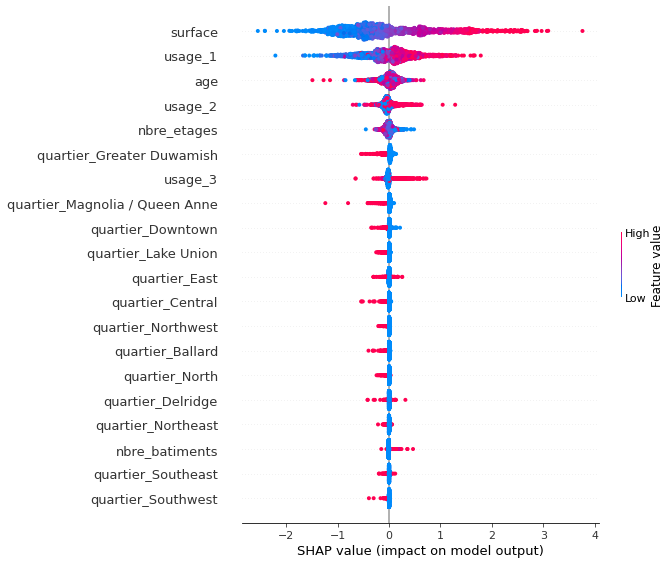

In [62]:
# XAI (SHAP) :
shap.summary_plot(shap_values, X_train)

#### 2) Pour la consommation d'énergie (optimisation des hyperparamètres + RFECV)

Label       RFECV_conso
MAE      3107902.855542
MAPE           0.899642
RMSE     8965466.633525
R²             0.732837
Time         7731.09375
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.1, max_delta_step=None, max_depth=50,\n             min_child_weight=2, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, ...) - RFECV_conso, dtype: object


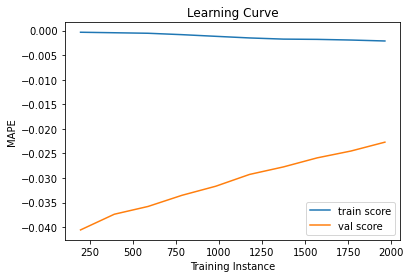

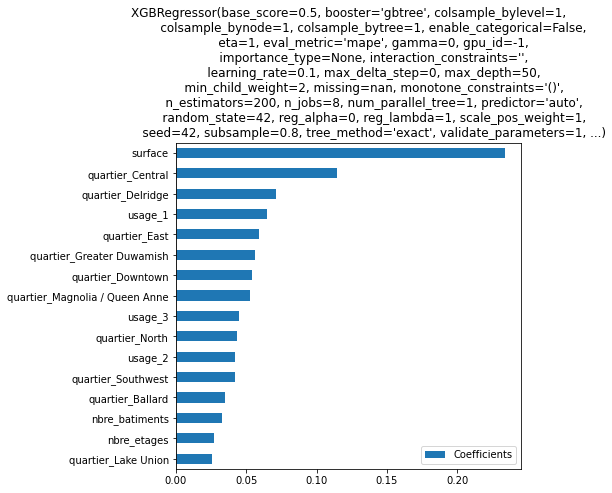

In [63]:
# XGBoost :
XGB = XGBRegressor(**grid_model.best_params_)
evaluation(XGB, X=X_train_RFECV_conso, Xt=X_test_RFECV_conso, label="RFECV_conso", type_coef="B")

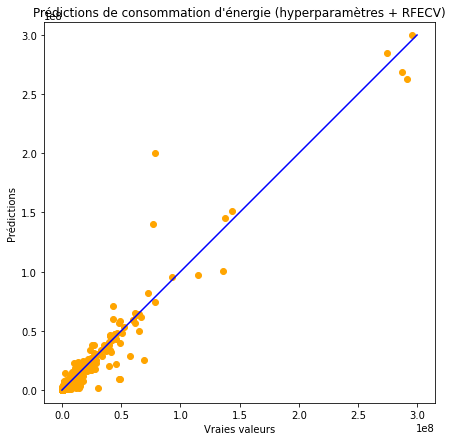

In [64]:
# Visualisation des prédictions :
XGB.fit(X_train_RFECV_conso, y_train)
predicted = XGB.predict(X_test_RFECV_conso)

plt.figure(figsize=(7,7))
plt.title("Prédictions de consommation d'énergie (hyperparamètres + RFECV)")
plt.scatter(np.exp(y_test), np.exp(predicted), c="orange")
p1 = max(max(np.exp(predicted)), max(np.exp(y_test)))
p2 = min(min(np.exp(predicted)), min(np.exp(y_test)))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel("Vraies valeurs")
plt.ylabel("Prédictions")
plt.axis('equal')
plt.show()

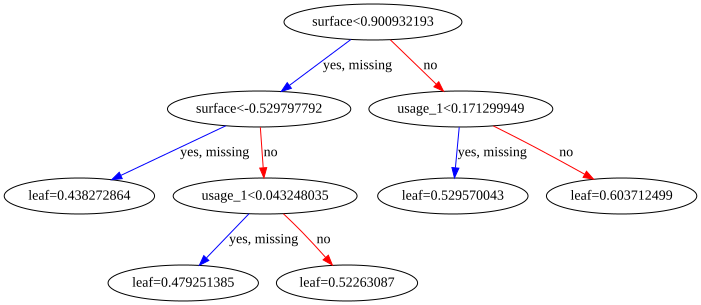

In [65]:
# Visualisation d'un arbre :
xgb.to_graphviz(XGB, num_trees=10)

In [66]:
# XAI (SHAP) :
shap.initjs()
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_train_RFECV_conso)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train_RFECV_conso.iloc[0,:])

In [67]:
# XAI (SHAP)
shap.force_plot(explainer.expected_value, shap_values, X_train_RFECV_conso)

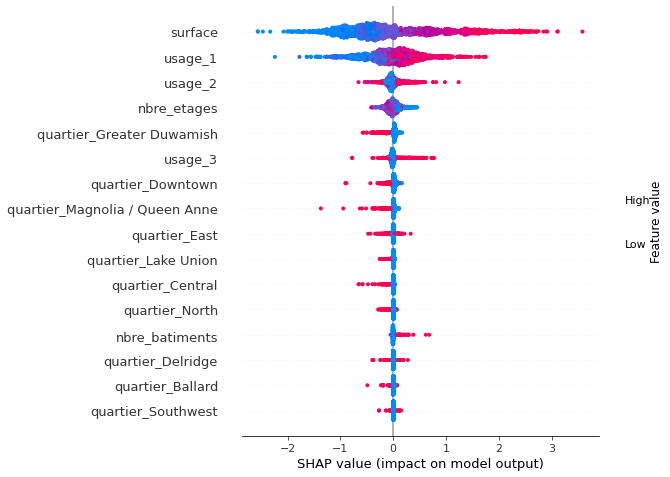

In [68]:
# Résumé des effets des variables
shap.summary_plot(shap_values, X_train_RFECV_conso)

#### 3) Pour la consommation d'énergie (optimisation des hyperparamètres + EnergyStar Score)

In [69]:
# Constitution d'un set avec l'EnergyStar Score :
X_train_energy = trainset.drop(columns = ["conso", "co2"]) 
X_test_energy = testset.drop(columns = ["conso", "co2"])

Label    energystar_conso
MAE        2918860.372517
MAPE             0.682254
RMSE       8882090.171012
R²               0.817347
Time            8641.0625
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.1, max_delta_step=None, max_depth=50,\n             min_child_weight=2, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, ...) - energystar_conso, dtype: object


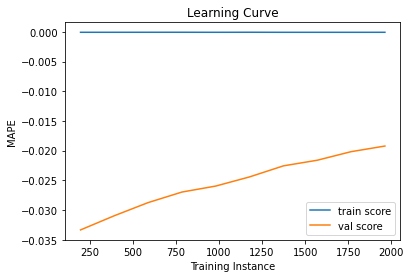

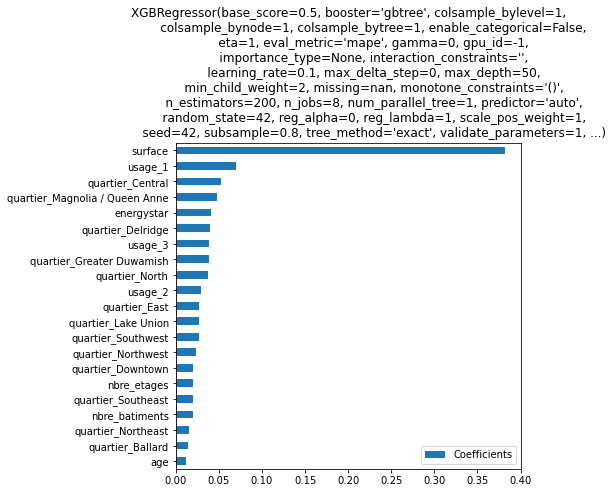

In [70]:
# XGBoost :
XGB = XGBRegressor(**grid_model.best_params_)
evaluation(XGB, X=X_train_energy, Xt=X_test_energy, label="energystar_conso", type_coef="B")

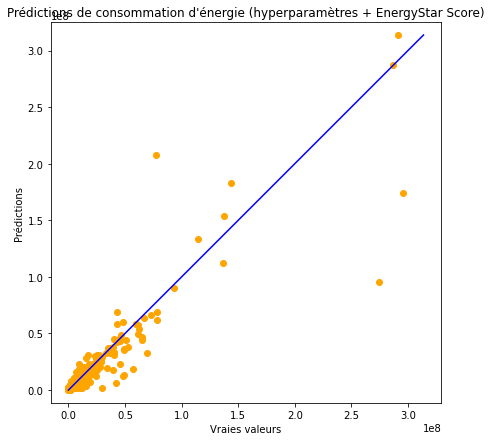

In [71]:
# Visualisation des prédictions :
XGB.fit(X_train_energy, y_train)
predicted = XGB.predict(X_test_energy)

plt.figure(figsize=(7,7))
plt.title("Prédictions de consommation d'énergie (hyperparamètres + EnergyStar Score)")
plt.scatter(np.exp(y_test), np.exp(predicted), c="orange")
p1 = max(max(np.exp(predicted)), max(np.exp(y_test)))
p2 = min(min(predicted), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel("Vraies valeurs")
plt.ylabel("Prédictions")
plt.axis('equal')
plt.show()

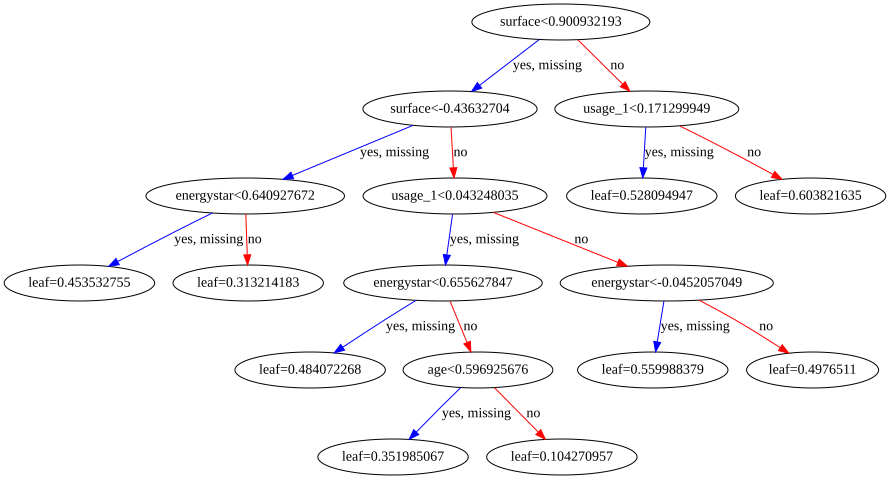

In [72]:
# Visualisation d'un arbre :
xgb.to_graphviz(XGB, num_trees=10)

In [73]:
# XAI (SHAP) :
shap.initjs()
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_train_energy)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train_energy.iloc[0,:])

In [74]:
# XAI (SHAP)
shap.force_plot(explainer.expected_value, shap_values, X_train_energy)

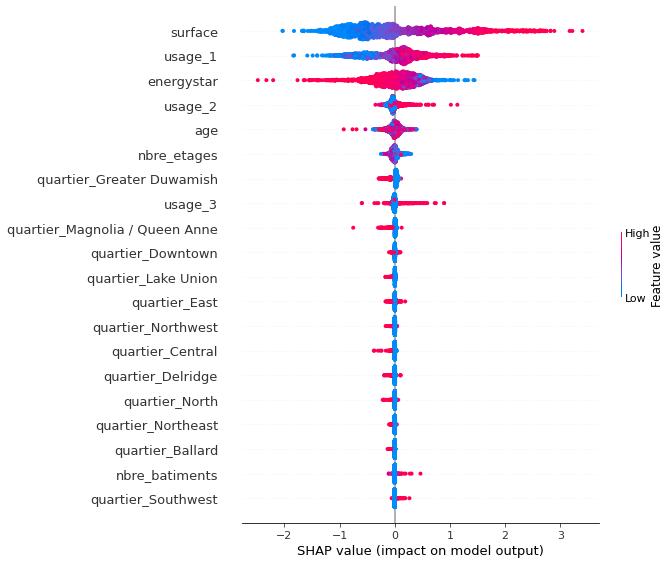

In [75]:
# Résumé des effets des variables
shap.summary_plot(shap_values, X_train_energy)

#### 4) Pour l'émission de co2 (optimisation des hyperparamètres) :

In [76]:
# Définitions des paramètres :
parameters = {"n_estimators" : [200],
              "max_depth" : [None, 50, 60],
              "learning_rate" : [0.1, 0.2],
              "min_child_weight" : [1, 2],
              "eta" : [1, 2],
              "subsample" : [0.6, 0.8, 1],
              "eval_metric" : ["mape"],
              "seed" : [42]}

In [77]:
# Récupération des meilleurs hyperparamètres (consommation d'énergie toutes variables):
grid_model = GridSearchCV(XGBRegressor(), parameters, cv=5)
grid_model.fit(X_train, y_train2)
grid_model.best_params_

{'eta': 1,
 'eval_metric': 'mape',
 'learning_rate': 0.1,
 'max_depth': 50,
 'min_child_weight': 1,
 'n_estimators': 200,
 'seed': 42,
 'subsample': 0.8}

Label            co2
MAE        95.750005
MAPE         2.66936
RMSE      295.500788
R²          0.526128
Time     11537.78125
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.1, max_delta_step=None, max_depth=50,\n             min_child_weight=1, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, ...) - co2, dtype: object


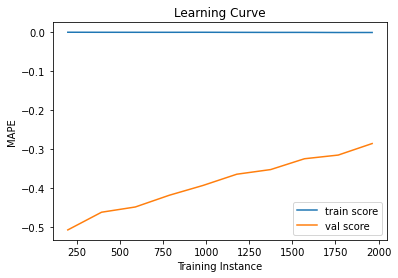

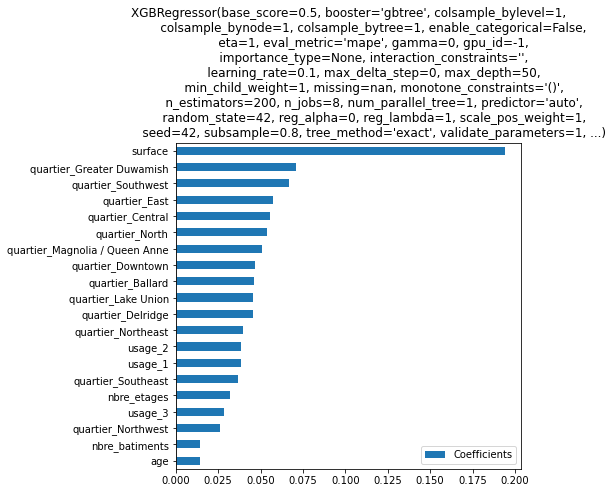

In [78]:
# XGBoost :
XGB = XGBRegressor(**grid_model.best_params_)
evaluation(XGB, y=y_train2, yt=y_test2, label="co2", type_coef="B")

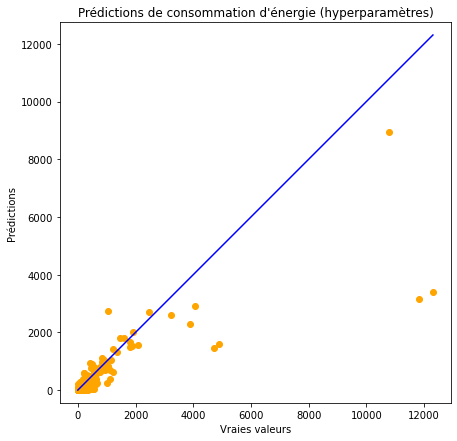

In [79]:
# Visualisation des prédictions :
XGB.fit(X_train, y_train2)
predicted = XGB.predict(X_test)

plt.figure(figsize=(7,7))
plt.title("Prédictions de consommation d'énergie (hyperparamètres)")
plt.scatter(np.exp(y_test2), np.exp(predicted), c="orange")
p1 = max(max(np.exp(predicted)), max(np.exp(y_test2)))
p2 = min(min(np.exp(predicted)), min(np.exp(y_test2)))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel("Vraies valeurs")
plt.ylabel("Prédictions")
plt.axis('equal')
plt.show()

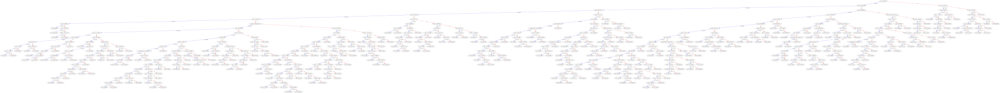

In [80]:
# Visualisation d'un arbre :
xgb.to_graphviz(XGB, num_trees=10)

In [81]:
# XAI (SHAP) :
shap.initjs()
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_train)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train.iloc[0,:])

In [82]:
# XAI (SHAP)
shap.force_plot(explainer.expected_value, shap_values, X_train)

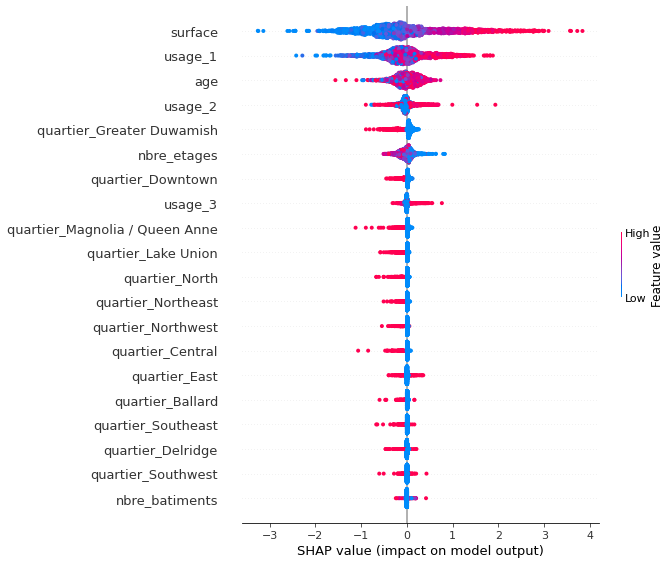

In [83]:
# Résumé des effets des variables
shap.summary_plot(shap_values, X_train)

#### 5) Pour l'émission de co2 (optimisation des hyperparamètres + RFECV)

Label       RFECV_co2
MAE         95.629688
MAPE          2.46871
RMSE        289.23686
R²           0.517924
Time     12570.390625
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.1, max_delta_step=None, max_depth=50,\n             min_child_weight=1, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, ...) - RFECV_co2, dtype: object


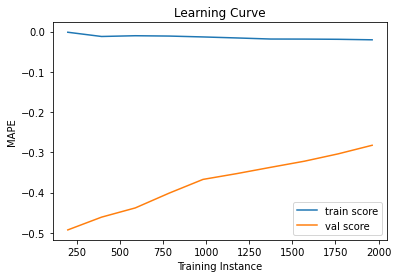

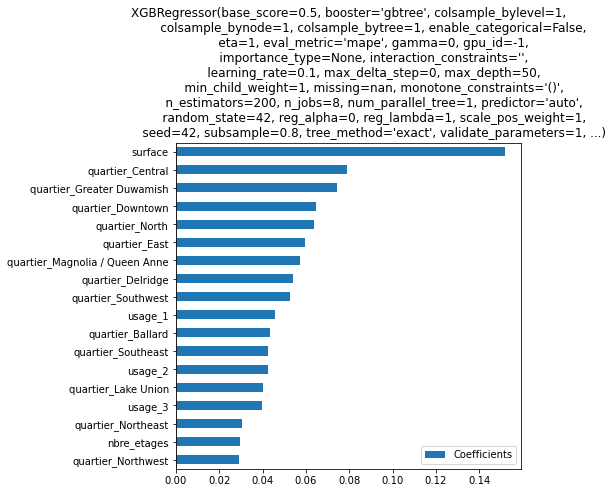

In [84]:
# XGBoost :
XGB = XGBRegressor(**grid_model.best_params_)
evaluation(XGB, X=X_train_RFECV_co2, Xt=X_test_RFECV_co2, y=y_train2, yt=y_test2, label="RFECV_co2", type_coef="B")

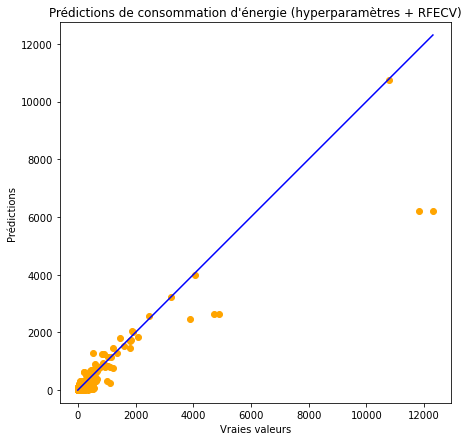

In [85]:
# Visualisation des prédictions :
XGB.fit(X_train_RFECV_co2, y_train2)
predicted = XGB.predict(X_test_RFECV_co2)

plt.figure(figsize=(7,7))
plt.title("Prédictions de consommation d'énergie (hyperparamètres + RFECV)")
plt.scatter(np.exp(y_test2), np.exp(predicted), c="orange")
p1 = max(max(np.exp(predicted)), max(np.exp(y_test2)))
p2 = min(min(np.exp(predicted)), min(np.exp(y_test2)))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel("Vraies valeurs")
plt.ylabel("Prédictions")
plt.axis('equal')
plt.show()

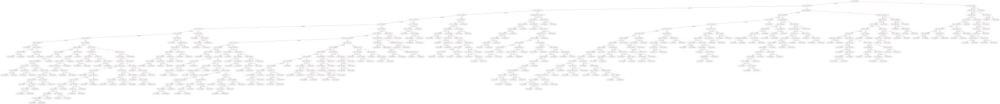

In [86]:
# Visualisation d'un arbre :
xgb.to_graphviz(XGB, num_trees=10)

In [87]:
# XAI (SHAP) :
shap.initjs()
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_train_RFECV_co2)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train_RFECV_co2.iloc[0,:])

In [88]:
# XAI (SHAP)
shap.force_plot(explainer.expected_value, shap_values, X_train_RFECV_co2)

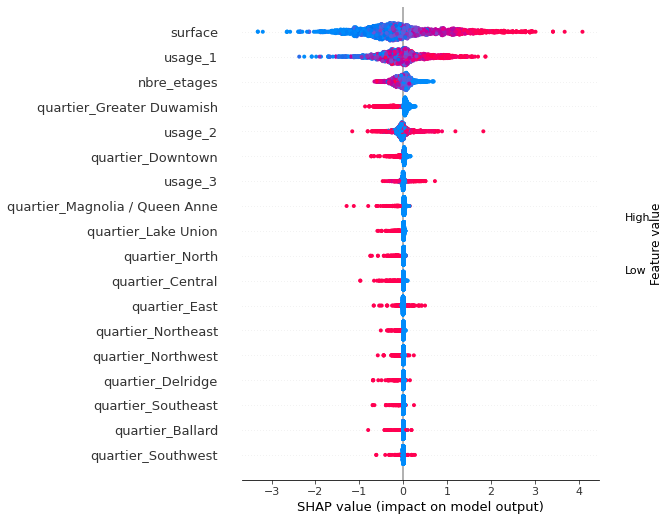

In [89]:
# Résumé des effets des variables
shap.summary_plot(shap_values, X_train_RFECV_co2)

#### 6) Pour l'émission de CO2 (optimisation des hyperparamètres + EnergyStar Score)

Label    energystar_co2
MAE           93.848725
MAPE           2.289817
RMSE         300.511696
R²             0.571433
Time       13637.796875
Name: XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n             colsample_bynode=None, colsample_bytree=None,\n             enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n             gpu_id=None, importance_type=None, interaction_constraints=None,\n             learning_rate=0.1, max_delta_step=None, max_depth=50,\n             min_child_weight=1, missing=nan, monotone_constraints=None,\n             n_estimators=200, n_jobs=None, num_parallel_tree=None,\n             predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n             scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n             validate_parameters=None, ...) - energystar_co2, dtype: object


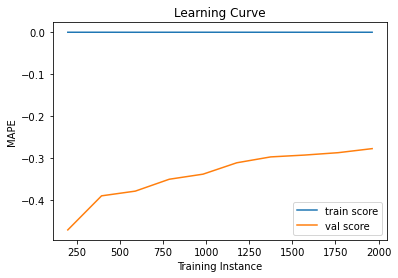

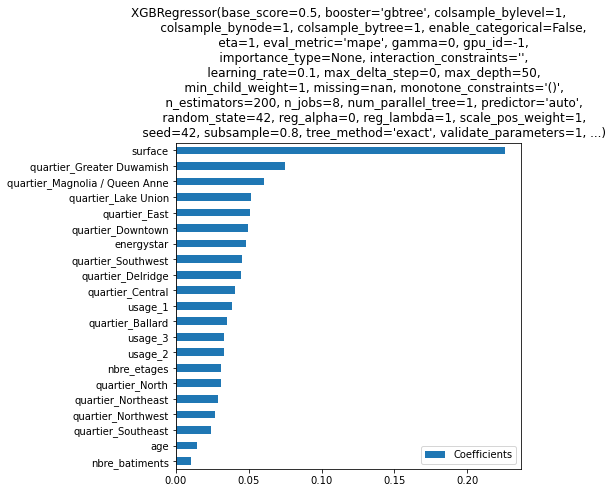

In [90]:
# XGBoost :
XGB = XGBRegressor(**grid_model.best_params_)
evaluation(XGB, X=X_train_energy, Xt=X_test_energy, y=y_train2, yt=y_test2, label="energystar_co2", type_coef="B")

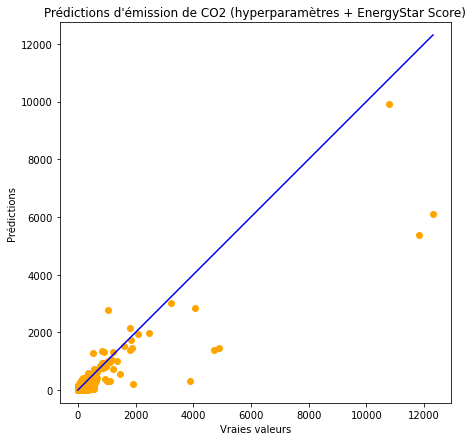

In [91]:
# Visualisation des prédictions :
XGB.fit(X_train_energy, y_train2)
predicted = XGB.predict(X_test_energy)

plt.figure(figsize=(7,7))
plt.title("Prédictions d'émission de CO2 (hyperparamètres + EnergyStar Score)")
plt.scatter(np.exp(y_test2), np.exp(predicted), c="orange")
p1 = max(max(np.exp(predicted)), max(np.exp(y_test2)))
p2 = min(min(np.exp(predicted)), min(np.exp(y_test2)))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel("Vraies valeurs")
plt.ylabel("Prédictions")
plt.axis('equal')
plt.show()

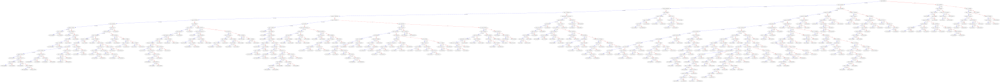

In [92]:
# Visualisation d'un arbre :
xgb.to_graphviz(XGB, num_trees=10)

In [93]:
# XAI (SHAP) :
shap.initjs()
explainer = shap.TreeExplainer(XGB)
shap_values = explainer.shap_values(X_train_energy)
shap.force_plot(explainer.expected_value, shap_values[0,:], X_train_energy.iloc[0,:])

In [94]:
# XAI (SHAP)
shap.force_plot(explainer.expected_value, shap_values, X_train_energy)

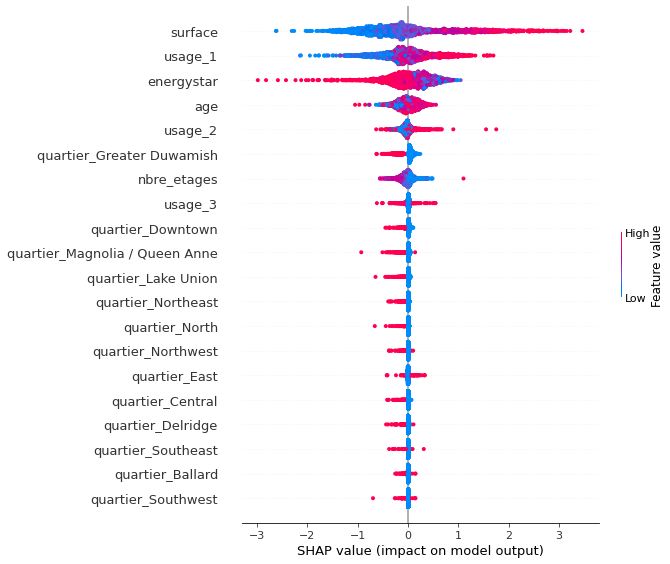

In [95]:
# Résumé des effets des variables
shap.summary_plot(shap_values, X_train_energy)

### D - Conclusion :

In [96]:
# Tableau récapitulatif consommation d'énergie :
scores[(scores["Label"]=="conso")|(scores["Label"]=="RFECV_conso")|(scores["Label"]=="energystar_conso")]

,Label,MAE,MAPE,RMSE,R²,Time
LinearRegression() - conso,conso,5.662448e+06,3.485242,1.154641e+07,0.688554,6.171875
Ridge(alpha=4.9) - conso,conso,5.648602e+06,3.470411,1.153605e+07,0.689335,16.343750
"LinearSVR(C=1, epsilon=0.001, loss='squared_epsilon_insensitive', tol=0.001) - conso",conso,1.316027e+09,531.751255,4.779137e+09,0.688649,31.062500
"RandomForestRegressor(bootstrap=False, max_depth=40, max_features='sqrt',\n min_samples_split=3, n_estimators=200) - conso",conso,3.403273e+06,1.097336,1.107830e+07,0.746185,123.562500
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.05, max_delta_step=None, max_depth=50,\n min_child_weight=None, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, verbosity=None) - conso",conso,3.019414e+06,0.882556,8.936525e+06,0.740335,3265.359375
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.1, max_delta_step=None, max_depth=50,\n min_child_weight=2, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, ...) - conso",conso,3.081541e+06,0.818667,9.130348e+06,0.755012,6799.625000
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.1, max_delta_step=None, max_depth=50,\n min_child_weight=2, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, ...) - RFECV_conso",RFECV_conso,3.107903e+06,0.899642,8.965467e+06,0.732837,7731.093750
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.1, max_delta_step=None, max_depth=50,\n min_child_weight=2, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, ...) - energystar_conso",energystar_conso,2.918860e+06,0.682254,8.882090e+06,0.817347,8641.062500


In [97]:
# Tableau récapitulatif consommation d'énergie :
scores[(scores["Label"]=="co2")|(scores["Label"]=="RFECV_co2")|(scores["Label"]=="energystar_co2")]

,Label,MAE,MAPE,RMSE,R²,Time
LinearRegression() - co2,co2,210.426556,11.301579,446.511504,0.443752,9.734375
Ridge(alpha=4.9) - co2,co2,209.660579,11.253705,446.004912,0.445155,22.312500
"LinearSVR(C=1, epsilon=1, tol=0.01) - co2",co2,5214.187604,40.676549,505.558339,0.439075,52.281250
"RandomForestRegressor(bootstrap=False, max_depth=80, max_features='sqrt',\n n_estimators=200) - co2",co2,103.433520,3.034962,309.702367,0.552997,201.703125
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.05, max_delta_step=None, max_depth=50,\n min_child_weight=None, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, verbosity=None) - co2",co2,96.308932,2.388745,298.652395,0.525554,4798.250000
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.1, max_delta_step=None, max_depth=50,\n min_child_weight=1, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, ...) - co2",co2,95.750005,2.669360,295.500788,0.526128,11537.781250
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.1, max_delta_step=None, max_depth=50,\n min_child_weight=1, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, ...) - RFECV_co2",RFECV_co2,95.629688,2.468710,289.236860,0.517924,12570.390625
"XGBRegressor(base_score=None, booster=None, colsample_bylevel=None,\n colsample_bynode=None, colsample_bytree=None,\n enable_categorical=False, eta=1, eval_metric='mape', gamma=None,\n gpu_id=None, importance_type=None, interaction_constraints=None,\n learning_rate=0.1, max_delta_step=None, max_depth=50,\n min_child_weight=1, missing=nan, monotone_constraints=None,\n n_estimators=200, n_jobs=None, num_parallel_tree=None,\n predictor=None, random_state=None, reg_alpha=None, reg_lambda=None,\n scale_pos_weight=None, seed=42, subsample=0.8, tree_method=None,\n validate_parameters=None, ...) - energystar_co2",energystar_co2,93.848725,2.289817,300.511696,0.571433,13637.796875


### E - Export du modèle pour API :

In [98]:
# XGBoost :
XGB = XGBRegressor(eta=1, eval_metric="mape", learning_rate=0.1, max_depth=50, min_child_weight=2,
                   n_estimators=200, seed=42, subsample=0.8)
XGB.fit(X_train, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             eta=1, eval_metric='mape', gamma=0, gpu_id=-1,
             importance_type=None, interaction_constraints='',
             learning_rate=0.1, max_delta_step=0, max_depth=50,
             min_child_weight=2, missing=nan, monotone_constraints='()',
             n_estimators=200, n_jobs=8, num_parallel_tree=1, predictor='auto',
             random_state=42, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=42, subsample=0.8, tree_method='exact', validate_parameters=1, ...)

In [99]:
# Export du modèle
joblib.dump(XGB, "XGB_model")

['XGB_model']